# Colorization Assignment_ 201835505 이하영

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os 
from matplotlib import pyplot as plt
import torch
from torch.utils import data
from torch.autograd import Variable
from torchvision import transforms
import torch.nn as nn
import random
import tqdm
from PIL import Image
import cv2
import numpy as np
from torchvision.transforms import Compose, ToTensor, ToPILImage

# Load Dataset and Unzip

In [3]:
file_name = 'colorization_dataset_v0.zip'
zip_path = os.path.join('/content/drive/MyDrive/colorization_dataset_v0.zip')

!cp "{zip_path}" . # copying content to our current workspace
!unzip -q "{file_name}" # unzipping the file
!rm "{file_name}" # removing original zip file

In [4]:
train_root = './training_images'
val_root = './validation_images'
test_root = './test_images'

train_examples = os.listdir(train_root)
val_examples= os.listdir(val_root)
test_examples = os.listdir(test_root)

print('length of train set : {}'.format(len(train_examples)))
print('length of validation set : {}'.format(len(val_examples)))
print('length of test set : {}'.format(len(test_examples)))

length of train set : 7000
length of validation set : 2000
length of test set : 1000


(256, 256, 3)


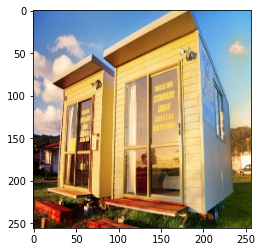

In [5]:
image = plt.imread(train_root + '/' + train_examples[0]) # reading first image in the training dataset
plt.imshow(image) # shoing the image using matplotlig
#plt.show(image)
print(image.shape)

# Define Network with Attention R2UNet

In [6]:
def init_weights(net, init_type='normal', gain=0.02):
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
            if init_type == 'normal':
                init.normal_(m.weight.data, 0.0, gain)
            elif init_type == 'xavier':
                init.xavier_normal_(m.weight.data, gain=gain)
            elif init_type == 'kaiming':
                init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            elif init_type == 'orthogonal':
                init.orthogonal_(m.weight.data, gain=gain)
            else:
                raise NotImplementedError('initialization method [%s] is not implemented' % init_type)
            if hasattr(m, 'bias') and m.bias is not None:
                init.constant_(m.bias.data, 0.0)
        elif classname.find('BatchNorm2d') != -1:
            init.normal_(m.weight.data, 1.0, gain)
            init.constant_(m.bias.data, 0.0)

    print('initialize network with %s' % init_type)
    net.apply(init_func)

class conv_block(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(conv_block,self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, kernel_size=3,padding=1,bias=True),
            nn.BatchNorm2d(ch_out),
            nn.ReLU(inplace=True),
            nn.Conv2d(ch_out, ch_out, kernel_size=3,padding=1,bias=True),
            nn.BatchNorm2d(ch_out),
            nn.ReLU(inplace=True)
        )


    def forward(self,x):
        x = self.conv(x)
        return x

class up_conv(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(up_conv,self).__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(ch_in,ch_out,kernel_size=3,stride=1,padding=1,bias=True),
		    nn.BatchNorm2d(ch_out),
			nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.up(x)
        return x

class Recurrent_block(nn.Module):
    def __init__(self,ch_out,t=2):
        super(Recurrent_block,self).__init__()
        self.t = t
        self.ch_out = ch_out
        self.conv = nn.Sequential(
            nn.Conv2d(ch_out,ch_out,kernel_size=3,stride=1,padding=1,bias=True),
		    nn.BatchNorm2d(ch_out),
			nn.ReLU(inplace=True)
        )

    def forward(self,x):
        for i in range(self.t):

            if i==0:
                x1 = self.conv(x)
            
            x1 = self.conv(x+x1)
        return x1
        
class RRCNN_block(nn.Module):
    def __init__(self,ch_in,ch_out,t=2):
        super(RRCNN_block,self).__init__()
        self.RCNN = nn.Sequential(
            Recurrent_block(ch_out,t=t),
            Recurrent_block(ch_out,t=t)
        )
        self.Conv_1x1 = nn.Conv2d(ch_in,ch_out,kernel_size=1,stride=1,padding=0)

    def forward(self,x):
        x = self.Conv_1x1(x)
        x1 = self.RCNN(x)
        return x+x1


class single_conv(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(single_conv,self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, kernel_size=3,stride=1,padding=1,bias=True),
            nn.BatchNorm2d(ch_out),
            nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.conv(x)
        return x

class Attention_block(nn.Module):
    def __init__(self,F_g,F_l,F_int):
        super(Attention_block,self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1,stride=1,padding=0,bias=True),
            nn.BatchNorm2d(F_int)
            )
        
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1,stride=1,padding=0,bias=True),
            nn.BatchNorm2d(F_int)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1,stride=1,padding=0,bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        
        self.relu = nn.ReLU(inplace=True)
        
    def forward(self,g,x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1+x1)
        psi = self.psi(psi)

        return x*psi


In [7]:
class R2AttU_Net(nn.Module):
    def __init__(self,img_ch=3,output_ch=2,t=2):
        super(R2AttU_Net,self).__init__()
        
        self.Maxpool = nn.MaxPool2d(kernel_size=2,stride=2)
        self.Upsample = nn.Upsample(scale_factor=2)

        self.RRCNN1 = RRCNN_block(ch_in=img_ch,ch_out=64,t=t)

        self.RRCNN2 = RRCNN_block(ch_in=64,ch_out=128,t=t)
        
        self.RRCNN3 = RRCNN_block(ch_in=128,ch_out=256,t=t)
        
        self.RRCNN4 = RRCNN_block(ch_in=256,ch_out=512,t=t)
        
        self.RRCNN5 = RRCNN_block(ch_in=512,ch_out=1024,t=t)
        

        self.Up5 = up_conv(ch_in=1024,ch_out=512)
        self.Att5 = Attention_block(F_g=512,F_l=512,F_int=256)
        self.Up_RRCNN5 = RRCNN_block(ch_in=1024, ch_out=512,t=t)
        
        self.Up4 = up_conv(ch_in=512,ch_out=256)
        self.Att4 = Attention_block(F_g=256,F_l=256,F_int=128)
        self.Up_RRCNN4 = RRCNN_block(ch_in=512, ch_out=256,t=t)
        
        self.Up3 = up_conv(ch_in=256,ch_out=128)
        self.Att3 = Attention_block(F_g=128,F_l=128,F_int=64)
        self.Up_RRCNN3 = RRCNN_block(ch_in=256, ch_out=128,t=t)
        
        self.Up2 = up_conv(ch_in=128,ch_out=64)
        self.Att2 = Attention_block(F_g=64,F_l=64,F_int=32)
        self.Up_RRCNN2 = RRCNN_block(ch_in=128, ch_out=64,t=t)

        self.Conv_1x1 = nn.Conv2d(64,output_ch,kernel_size=1,stride=1,padding=0)


    def forward(self,l_image, ab_image):
        input_image = torch.cat((l_image, ab_image),dim=1)
        # encoding path
        x1 = self.RRCNN1(input_image)

        x2 = self.Maxpool(x1)
        x2 = self.RRCNN2(x2)
        
        x3 = self.Maxpool(x2)
        x3 = self.RRCNN3(x3)

        x4 = self.Maxpool(x3)
        x4 = self.RRCNN4(x4)

        x5 = self.Maxpool(x4)
        x5 = self.RRCNN5(x5)

        # decoding + concat path
        d5 = self.Up5(x5)
        x4 = self.Att5(g=d5,x=x4)
        d5 = torch.cat((x4,d5),dim=1)
        d5 = self.Up_RRCNN5(d5)
        
        d4 = self.Up4(d5)
        x3 = self.Att4(g=d4,x=x3)
        d4 = torch.cat((x3,d4),dim=1)
        d4 = self.Up_RRCNN4(d4)

        d3 = self.Up3(d4)
        x2 = self.Att3(g=d3,x=x2)
        d3 = torch.cat((x2,d3),dim=1)
        d3 = self.Up_RRCNN3(d3)

        d2 = self.Up2(d3)
        x1 = self.Att2(g=d2,x=x1)
        d2 = torch.cat((x1,d2),dim=1)
        d2 = self.Up_RRCNN2(d2)

        d1 = self.Conv_1x1(d2)

        return d1

In [8]:
l = torch.rand(1,1,256,256).cuda()
ab = torch.rand(1,2,256,256).cuda()
net = R2AttU_Net().cuda()
out = net(l, ab)
print(out.shape)

torch.Size([1, 2, 256, 256])


# Transform the dataset with the mode

In [9]:
class ColorHintTransform(object):
  def __init__(self, size=64, mode = "training"):
    super(ColorHintTransform, self).__init__()
    self.size = size
    self.mode = mode
    self.transforms = Compose([ToTensor()])

  def bgr_to_lab(self, img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, ab = lab[:, :, 0], lab[:, :, 1:]
    return l, ab

  def hint_mask(self, bgr, threshold=[0.95, 0.97, 0.99]):
    h, w, c = bgr.shape
    mask_threshold = random.choice(threshold)
    mask = np.random.random([h, w, 1]) > mask_threshold
    return mask

  def __call__(self, img, mask_img=None):
    threshold = [0.95, 0.97, 0.99]
    if (self.mode == "training") | (self.mode == "validation") :
      image = cv2.resize(img, (self.size, self.size))
      mask = self.hint_mask(image, threshold)

      hint_image = image * mask

      l, ab = self.bgr_to_lab(image)
      l_hint, ab_hint = self.bgr_to_lab(hint_image)

      return self.transforms(l), self.transforms(ab), self.transforms(ab_hint)

    elif self.mode == "testing":
      image = cv2.resize(img, (self.size, self.size))
      l, ab_hint = self.bgr_to_lab(image)

      return self.transforms(l), self.transforms(ab_hint)

    else:
      return NotImplementedError

image shape (256, 256, 3)


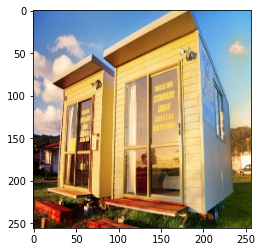

In [10]:
class ColorHintDataset(data.Dataset):
  def __init__(self, root_path, size):
    super().__init__

    self.root_path = root_path # root path - images that will be used
    self.samples = None # samples
    self.transforms = None # augmentation 
    self.size = size # resize shape of the image

  def set_mode(self, mode):
    self.mode = mode # training/validation/ test
    self.transforms = ColorHintTransform(self.size, mode)
    if (self.mode == "training") | (self.mode == "validation") | (self.mode == "testing"):
      self.samples =  [img for img in os.listdir(self.root_path)] # loop 
    else:
      raise NotImplementedError
  
  def __len__(self):
    return len(self.samples)
  
  def __getitem__(self, idx):
    if (self.mode == "training") | (self.mode == "validation"):
      filename = self.samples[idx] # one image using the index -> list[index]
      img = cv2.imread(os.path.join(self.root_path, filename)) # cv2 reads image in BGR mode
      l, ab, hint = self.transforms(img) # 3 tensors -> l image, ab image, hint image
      sample = {"l": l, "ab": ab, "hint": hint, "filename" : filename}

    elif self.mode == "testing":
      filename = self.samples[idx]
      img = cv2.imread(os.path.join(self.root_path, filename))
      l, hint = self.transforms(img)
      sample = {"l": l, "hint": hint, "filename" : filename}

    return sample
  
print('image shape', image.shape)
plt.imshow(image)

In [11]:
train_root = './training_images/'
val_root = './validation_images/'
test_root = './test_images/'

# Dataloader setting
train_dataset = ColorHintDataset(train_root, 128)
train_dataset.set_mode("training")

val_dataset = ColorHintDataset(val_root, 128)
val_dataset.set_mode("validation")


test_dataset = ColorHintDataset(test_root, 128)
test_dataset.set_mode("testing")

print("Train samples #: ", len(train_dataset))
print("Val samples #: ", len(val_dataset))
print("Test samples #: ", len(test_dataset))

Train samples #:  7000
Val samples #:  2000
Test samples #:  1000


torch.Size([4, 1, 128, 128]) torch.Size([4, 2, 128, 128])


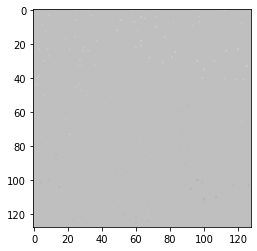

In [12]:
# finally, the dataloader
train_dataloader = data.DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = data.DataLoader(val_dataset, batch_size=4, shuffle=False)
test_dataloader = data.DataLoader(test_dataset, batch_size=1, shuffle=False)

# iterable
batch = iter(train_dataloader)
sample = batch.next()

# check 
l_image = sample['l']
ab_image = sample['ab']
hint_image = sample['hint']
file_name = sample['filename']

print(l_image.shape, ab_image.shape)

plt.imshow(ToPILImage()(hint_image[0]))

# Experiment environment settings

In [13]:
# %load_ext tensorboard
%reload_ext tensorboard

In [14]:
!pip install tensorboardx

     |████████████████████████████████| 124 kB 11.6 MB/s 


In [15]:
import torchvision.utils as tvutils
from tensorboardX import SummaryWriter
import tqdm.notebook as tq
from skimage import metrics

In [16]:
def batch_PSNR(img, imclean, data_range):
    Img = img.data.cpu().numpy().astype(np.float32)
    Iclean = imclean.data.cpu().numpy().astype(np.float32)
    PSNR = 0
    for i in range(Img.shape[0]):
        PSNR += metrics.peak_signal_noise_ratio(Iclean[i, :, :, :], Img[i, :, :, :], data_range=data_range)
    return (PSNR/Img.shape[0])

def BGR_RGB(img):
  device = img.device
  conv_image = []
  img = img.detach().cpu()
  for i in range(img.shape[0]):
    im = np.asarray(ToPILImage()(img[i]))
    im = cv2.cvtColor(im, cv2.COLOR_LAB2RGB)
    conv_image.append(ToTensor()(im))
  conv_image = torch.stack(conv_image)
  return conv_image.to(device)

In [17]:
x =torch.rand(4,3,256,256)
out = BGR_RGB(x)
print(out.shape)

torch.Size([4, 3, 256, 256])


In [37]:
%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

# Proceed model training and validation

In [38]:
# Change to your data root directory
root_path = "/content/"
save_path = "/content/drive/MyDrive/Colorization Models"

# Depend on runtime setting
use_cuda = True

# Model 불러오기
state_dict = torch.load('/content/drive/MyDrive/17.tar')
model = R2AttU_Net()
model.load_state_dict(state_dict, strict=True)

# loss
criterion = nn.MSELoss(size_average=False)

if use_cuda:
  model.to('cuda')
  criterion.to('cuda')

# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001, eps=1e-08)

step = 0
# Tensorboard writer
writer = SummaryWriter("logs")

for epoch in range(17,21):
  print('Epoch {}/{}'.format(epoch + 1, 20))
  print('-' * 10)

  for i, data in enumerate(tq.tqdm(train_dataloader)):
    if use_cuda:
      l = data["l"].to('cuda')
      ab = data["ab"].to('cuda')
      hint = data["hint"].to('cuda')
    
    model.train()
    model.zero_grad()
    optimizer.zero_grad()

    preds = model(l, hint)

    loss = criterion(preds, ab)

    loss.backward()
    optimizer.step()
    
    gt_image = torch.cat((l, ab), dim=1)
    pred_image = torch.cat((l, preds), dim=1)
    psnr_train = batch_PSNR(gt_image, pred_image, 1.)

    if step % 1 == 0:
      # Log the scalar values
      writer.add_scalar('loss', loss.item(), step)
      writer.add_scalar('PSNR on training data', psnr_train, step)

      # log the images => Tensorboard
      l_image_vis = l.repeat(1,3,1,1)
      gt_vis = BGR_RGB(pred_image)
      pred_vis = BGR_RGB(gt_image)
      all_image = torch.cat([l_image_vis, gt_vis, pred_vis], dim=2)
      writer.add_images('train_image', all_image, epoch)
      print("[epoch %d][%d/%d] loss: %.4f PSNR_train: %.4f" %
          (epoch + 1, i + 1, len(train_dataloader), loss.item(), psnr_train))
    step += 1
    
  torch.save(model.state_dict(), os.path.join(save_path, "{}.tar".format(epoch+1)))
  print("saved at {}".format(os.path.join(save_path, "{}.tar".format(epoch+1))))

  psnr_val = []

  # Validation on training phase
  model.eval()
  with torch.no_grad():
    for val_data in tq.tqdm(val_dataloader):
      l = val_data["l"].to('cuda')
      ab = val_data["ab"].to('cuda')
      hint = val_data["hint"].to('cuda')

      preds = model(l, hint)

      gt_image = torch.cat((l, ab), dim=1)
      pred_image = torch.cat((l, preds), dim=1)
      psnr = batch_PSNR(gt_image, pred_image, 1.)
      psnr_val.append(psnr)

      # log the images => Tensorboard
      l_image_vis = l.repeat(1,3,1,1)
      gt_vis = BGR_RGB(pred_image)
      pred_vis = BGR_RGB(gt_image)
      all_image = torch.cat([l_image_vis, gt_vis, pred_vis], dim=2)
      writer.add_images('val_images', all_image, epoch)
    
    mean_val = np.mean(psnr_val)
    print("\n[epoch %d] PSNR_val: %.4f" % (epoch + 1, mean_val))
    writer.add_scalar('PSNR on validation data', mean_val, epoch)

Epoch 18/20
----------


/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


  0%|          | 0/1750 [00:00<?, ?it/s]

[epoch 18][1/1750] loss: 41.2133 PSNR_train: 37.5613
[epoch 18][2/1750] loss: 96.5564 PSNR_train: 33.6827
[epoch 18][3/1750] loss: 112.4358 PSNR_train: 34.3157
[epoch 18][4/1750] loss: 124.3131 PSNR_train: 34.2491
[epoch 18][5/1750] loss: 138.4909 PSNR_train: 34.2557
[epoch 18][6/1750] loss: 43.8872 PSNR_train: 37.5520
[epoch 18][7/1750] loss: 85.4472 PSNR_train: 33.8956
[epoch 18][8/1750] loss: 127.8479 PSNR_train: 32.3574
[epoch 18][9/1750] loss: 79.5952 PSNR_train: 34.5971
[epoch 18][10/1750] loss: 48.1272 PSNR_train: 36.1549
[epoch 18][11/1750] loss: 112.1282 PSNR_train: 34.0946
[epoch 18][12/1750] loss: 51.3230 PSNR_train: 36.5771
[epoch 18][13/1750] loss: 97.3010 PSNR_train: 34.3671
[epoch 18][14/1750] loss: 45.7625 PSNR_train: 36.3562
[epoch 18][15/1750] loss: 176.9640 PSNR_train: 33.3386
[epoch 18][16/1750] loss: 54.9931 PSNR_train: 36.0018
[epoch 18][17/1750] loss: 48.7804 PSNR_train: 36.3431
[epoch 18][18/1750] loss: 54.3318 PSNR_train: 37.4125
[epoch 18][19/1750] loss: 74.44

  0%|          | 0/500 [00:00<?, ?it/s]


[epoch 18] PSNR_val: 28.2548
Epoch 19/20
----------


  0%|          | 0/1750 [00:00<?, ?it/s]

[epoch 19][1/1750] loss: 44.0570 PSNR_train: 37.6441
[epoch 19][2/1750] loss: 59.7149 PSNR_train: 36.1276
[epoch 19][3/1750] loss: 57.2464 PSNR_train: 35.8936
[epoch 19][4/1750] loss: 35.8323 PSNR_train: 38.2246
[epoch 19][5/1750] loss: 33.7421 PSNR_train: 38.0086
[epoch 19][6/1750] loss: 25.1033 PSNR_train: 40.3821
[epoch 19][7/1750] loss: 89.1826 PSNR_train: 34.6476
[epoch 19][8/1750] loss: 63.0153 PSNR_train: 35.8253
[epoch 19][9/1750] loss: 44.3664 PSNR_train: 36.7289
[epoch 19][10/1750] loss: 80.8716 PSNR_train: 34.5220
[epoch 19][11/1750] loss: 55.4977 PSNR_train: 37.2215
[epoch 19][12/1750] loss: 55.6765 PSNR_train: 35.7077
[epoch 19][13/1750] loss: 71.1471 PSNR_train: 34.9090
[epoch 19][14/1750] loss: 39.8635 PSNR_train: 37.5949
[epoch 19][15/1750] loss: 91.1171 PSNR_train: 33.8056
[epoch 19][16/1750] loss: 79.4492 PSNR_train: 34.5366
[epoch 19][17/1750] loss: 183.5200 PSNR_train: 31.4800
[epoch 19][18/1750] loss: 64.3086 PSNR_train: 35.0253
[epoch 19][19/1750] loss: 63.3121 PS

  0%|          | 0/500 [00:00<?, ?it/s]


[epoch 19] PSNR_val: 29.2473
Epoch 20/20
----------


  0%|          | 0/1750 [00:00<?, ?it/s]

[epoch 20][1/1750] loss: 35.9975 PSNR_train: 39.9100
[epoch 20][2/1750] loss: 65.2835 PSNR_train: 35.3295
[epoch 20][3/1750] loss: 51.9688 PSNR_train: 36.2304
[epoch 20][4/1750] loss: 49.9514 PSNR_train: 36.6653
[epoch 20][5/1750] loss: 31.9876 PSNR_train: 38.2397
[epoch 20][6/1750] loss: 73.9492 PSNR_train: 34.8645
[epoch 20][7/1750] loss: 56.1230 PSNR_train: 35.7239
[epoch 20][8/1750] loss: 48.0471 PSNR_train: 37.5775
[epoch 20][9/1750] loss: 85.2592 PSNR_train: 35.4580
[epoch 20][10/1750] loss: 55.9521 PSNR_train: 38.2038
[epoch 20][11/1750] loss: 48.3814 PSNR_train: 36.3794
[epoch 20][12/1750] loss: 128.4069 PSNR_train: 32.1281
[epoch 20][13/1750] loss: 57.3445 PSNR_train: 35.4733
[epoch 20][14/1750] loss: 51.2764 PSNR_train: 36.1286
[epoch 20][15/1750] loss: 126.2417 PSNR_train: 32.1410
[epoch 20][16/1750] loss: 84.9566 PSNR_train: 34.5579
[epoch 20][17/1750] loss: 63.1200 PSNR_train: 36.2722
[epoch 20][18/1750] loss: 143.5598 PSNR_train: 33.1744
[epoch 20][19/1750] loss: 84.9346 

  0%|          | 0/500 [00:00<?, ?it/s]


[epoch 20] PSNR_val: 27.0753
Epoch 21/20
----------


  0%|          | 0/1750 [00:00<?, ?it/s]

[epoch 21][1/1750] loss: 50.9754 PSNR_train: 37.5119
[epoch 21][2/1750] loss: 44.6756 PSNR_train: 37.1819
[epoch 21][3/1750] loss: 54.3840 PSNR_train: 36.4972
[epoch 21][4/1750] loss: 57.5039 PSNR_train: 36.9192
[epoch 21][5/1750] loss: 60.1969 PSNR_train: 35.8318
[epoch 21][6/1750] loss: 53.4558 PSNR_train: 37.6923
[epoch 21][7/1750] loss: 38.7658 PSNR_train: 37.4772
[epoch 21][8/1750] loss: 188.3272 PSNR_train: 31.9478
[epoch 21][9/1750] loss: 102.2665 PSNR_train: 35.8476
[epoch 21][10/1750] loss: 63.3053 PSNR_train: 35.7667
[epoch 21][11/1750] loss: 109.8839 PSNR_train: 35.5263
[epoch 21][12/1750] loss: 36.8251 PSNR_train: 37.3968
[epoch 21][13/1750] loss: 61.5819 PSNR_train: 35.4504
[epoch 21][14/1750] loss: 58.3357 PSNR_train: 36.7211
[epoch 21][15/1750] loss: 49.7102 PSNR_train: 37.0911
[epoch 21][16/1750] loss: 46.4255 PSNR_train: 38.1291
[epoch 21][17/1750] loss: 48.3340 PSNR_train: 36.8183
[epoch 21][18/1750] loss: 116.8168 PSNR_train: 35.4216
[epoch 21][19/1750] loss: 92.3368

  0%|          | 0/500 [00:00<?, ?it/s]


[epoch 21] PSNR_val: 14.8568


# Save the test result

In [33]:
from torchvision.utils import save_image

def image_save(img, save_path):
  save_path += '.png'
  save_image(img, save_path)
  
result_save_path = '/content/drive/MyDrive/result'

In [34]:
with torch.no_grad():
    for test_data in tq.tqdm(test_dataloader):
      l = test_data["l"].to('cuda')
      hint = test_data["hint"].to('cuda')
      file_name = test_data["filename"][0][:-4]

      preds = model(l, hint)

      pred_image = torch.cat((l, preds), dim=1)
      final = BGR_RGB(pred_image)
      image_save(final, os.path.join(result_save_path, file_name))
    
    print("Finish")

  0%|          | 0/1000 [00:00<?, ?it/s]

Finish


# Finish